## dokumentacja do projektu "analiza i przetrwarzanie cech sygnału audio w dziedzinie czasu" - Analiza i Przetwarzanie dźwięku - Piotr Bielecki

# 0. Materiały do analizy, niezbędne paczki

* materiały do analizy:
  * mój głos nagrany podczas zajęć
  * głos koleżanki, również nagrany podczas zajęć
  * fragmenty utworu "Master of Puppets" - Metallica
  * fragmenty "Requiem" - Mozart
* niezbędne paczki:
  * pandas
  * numpy
  * matplotlib
  * librosa
  * os
  * Ipython

# 1. cel projektu

Projekt miał na celu przetworzenie sygnału zawartego w plikach o formacie .wav w celu analizy. Wydzielone cechy to cechy sygnału audio w dziedzinie czasu.
W projekcie wyekstrahowane zostały cechy związane z całymi klipami, a także te, związane z fragmentami klipu (tzw. "ramki")

# 2. Zawartość Projektu

Projekt złożony jest z dwóch notatników Jupyter - jeden, właściwy plik zawierający funkcje niezbędne ekstrakcji cech z plików .wav, drugi - dokumentacja i opracowanie wyników.

### 2.1 Notatnik "Projekt" zawiera:
* wczytanie plików do ramki danych
* funkcje dotyczące ekstrakcji cech:
  * na poziomie klipu:
    * odchylenie standardowe głośności, znormalizowane przez maksymalną głośność w klipie (VSTD)
    * Dynamiczny zasięg głośności w klipie (VDR)
    * Odsetek liczby ramek, w których STE jest mniejsze niż 50% średniego STE
    * Entropia energii
    * odchylenie standardowe ZCR
    * Dynamiczny zasięg głośności (VDR)
    * HZCRR - liczba oznaczająca proporcję wysokoczęstościowych przejść przez 0 w spróbkowanej fali
  * na poziomie ramki:
    * głośność 
    * Energia krótkookresowa (STE)
    * liczba przejść przez 0 amplitudy (ZCR)
    * współczynnik ciszy (SR)
    * częstotliwość tonu podstawowego / częstotliwość bazowa (f0)
* funkcje tworzące wykresy z wyekstrahowanych cech
* zapis ramki do pliku o formacie .json

### 2.2 Notatnik "dokumentacja" zawiera:
* detekcja ciszy
* określanie fragmentów dźwięcznych i bezdźwięcznych
* porównanie nagrań:
  * głosu męskiego i damskiego
  * muzyki, głosu oraz muzyki i głosu

# 3. Wykresy i wartości

## 3.1 Jak rozumieć wykresy

na podstawie poniższego przykładu przybliżę, jak rozumieć przedstawione w dokumentacji wykresy:
* pierwszy wykres - wykres amplitudy to po prostu wykres spróbkowanych wartości w czasie
  * naniesiony na wykresie zielony kolor oznacza fragmenty nagrania, które sklasyfikowane zostały jako fragmenty dzwięczne. 
* drugi wykres to wykres głośności w czasie
* trzeci wykres to wykres energii krótkookresowej w nagraniu
* czwarty wykres przedstawia częstość przechodzenia przez 0 sygnału wejściowego (spróbkowanego)
  * występujący na tych trzech wykresach czerwony kolor reprezentuje ciszę, jak wyliczona dzięki Współczynnikowi ciszy
* piąty wykres to spektrogram częstotliwości występujących w nagraniu, jak w każdym poprzednim wykresie, czas jest na osi poziomej
  * wykres należy rozumieć następująco: im jaśniejszy jest fragment, tym większa intensywność danych częstotliwości w nagraniu w danej chwili
  * na wykresie naniesione zostały również okazjonalne niebieskie fragmenty, oznaczające, że z dużym prawdopodobieństwem to jest częstotliwość bazowa danego fragmentu nagrania (określanie częstotliwości bazowej to problem probabilistyczny, dlatego nie zawsze niebieska linia będzie obecna)
    * korzystam tu ze zmodyfikowanego algorytmu YIN

Values for the whole clip:
	 name = aba_2.wav 
	 duration = 0.4207709751
	 Volume Standard Deviation = 0.34652140740000004
	 Volume dynamic range = 0.9928226471
	 standard deviation of ZCR = 13.4917641853	
	 High zero crossing rate = 10.5 
	 entropy = 4.9702987671 
	 Low Ste Ratio = 9.5


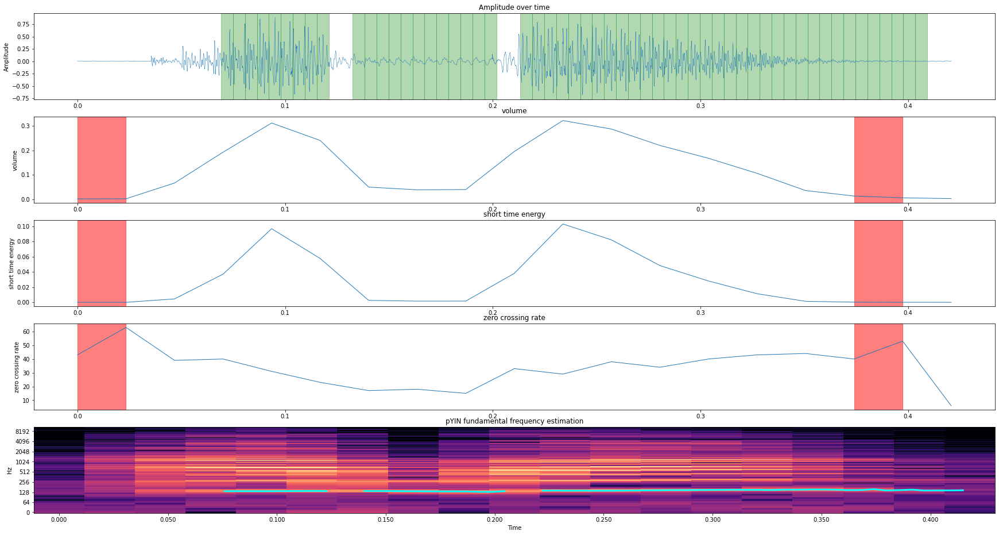

In [139]:
plot_features_df(df_male.iloc[1])

## 3.2 detekcja ciszy

Values for the whole clip:
	 name = mop_silence_1.wav 
	 duration = 3.8378684807
	 Volume Standard Deviation = 0.2002226412
	 Volume dynamic range = 0.9991412163000001
	 standard deviation of ZCR = 44.8294829033	
	 High zero crossing rate = 97.5 
	 entropy = 8.371720314 
	 Low Ste Ratio = 27.375


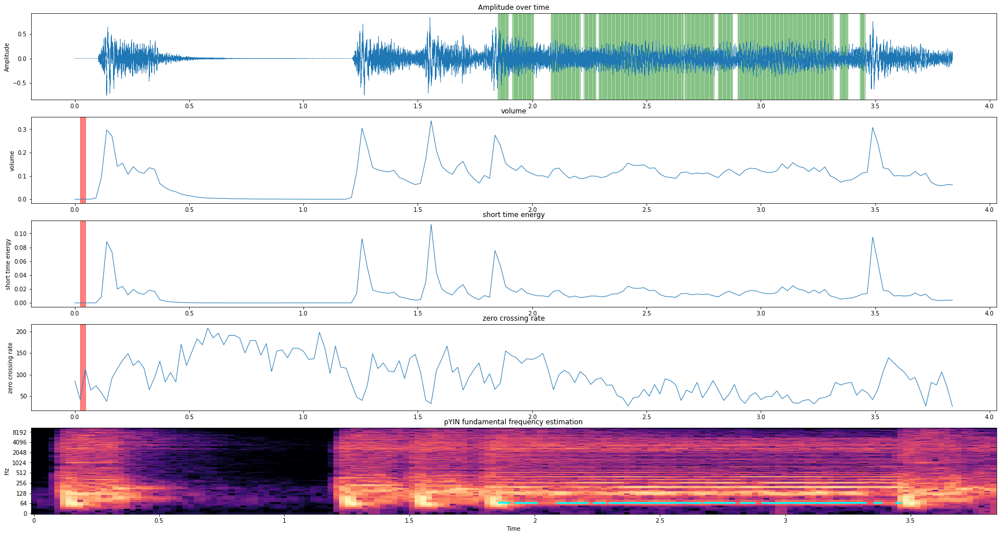

In [115]:
plot_features_df(df_music.iloc[6])

Values for the whole clip:
	 name = mop_silence_2.wav 
	 duration = 3.7797278912000003
	 Volume Standard Deviation = 0.2502183318
	 Volume dynamic range = 0.9948880672
	 standard deviation of ZCR = 37.8175373797	
	 High zero crossing rate = 87.0 
	 entropy = 8.4635219574 
	 Low Ste Ratio = 27.625


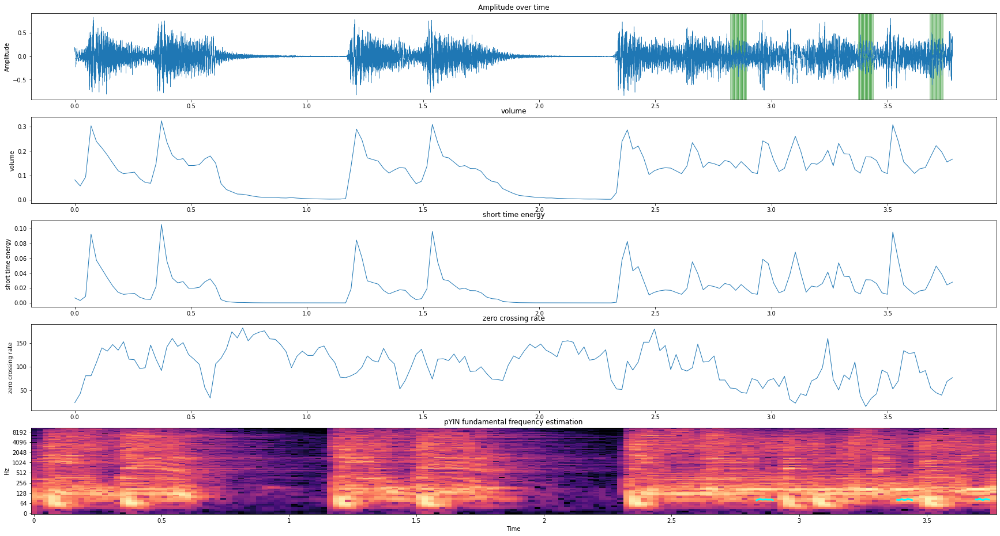

In [116]:
plot_features_df(df_music.iloc[7])

Values for the whole clip:
	 name = mop_silence_3.wav 
	 duration = 3.9541496599
	 Volume Standard Deviation = 0.2520399094
	 Volume dynamic range = 0.9938412905
	 standard deviation of ZCR = 40.103785367	
	 High zero crossing rate = 92.0 
	 entropy = 8.5421981812 
	 Low Ste Ratio = 28.75


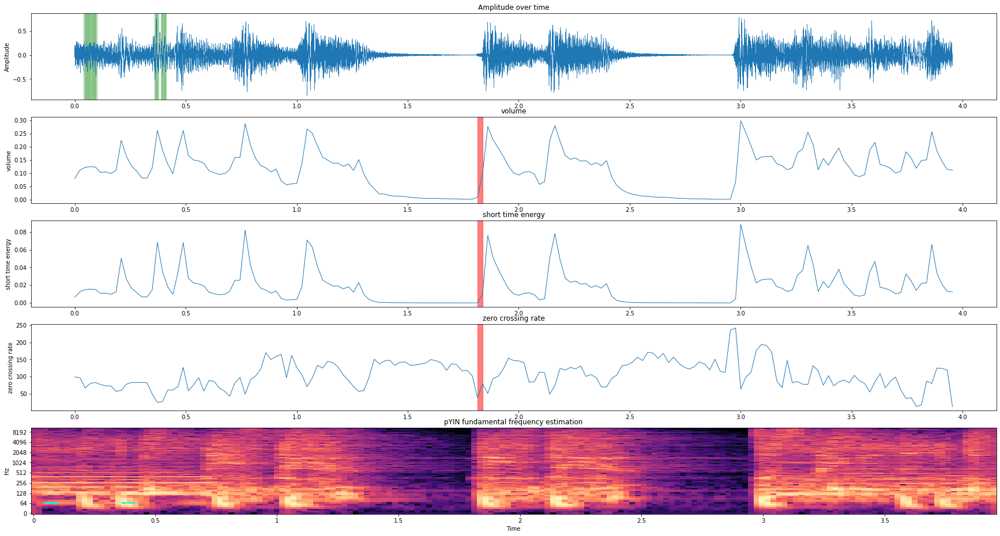

In [117]:
plot_features_df(df_music.iloc[8])

na powyższych trzech nagraniach nie wykryto ciszy, mimo iż głośność wskazywałaby, że ta cisza jest. Liczba przejść przez zero jest zbyt duża - w tym przypadku dlatego, że wciąż mamy wibracje z ostatniego dzwięku przed pauzą

Values for the whole clip:
	 name = requiem_silence_1.wav 
	 duration = 10.0689795918
	 Volume Standard Deviation = 0.28128728270000003
	 Volume dynamic range = 0.9998449683
	 standard deviation of ZCR = 17.186611232	
	 High zero crossing rate = 262.0 
	 entropy = 9.689081192 
	 Low Ste Ratio = 28.9545454545


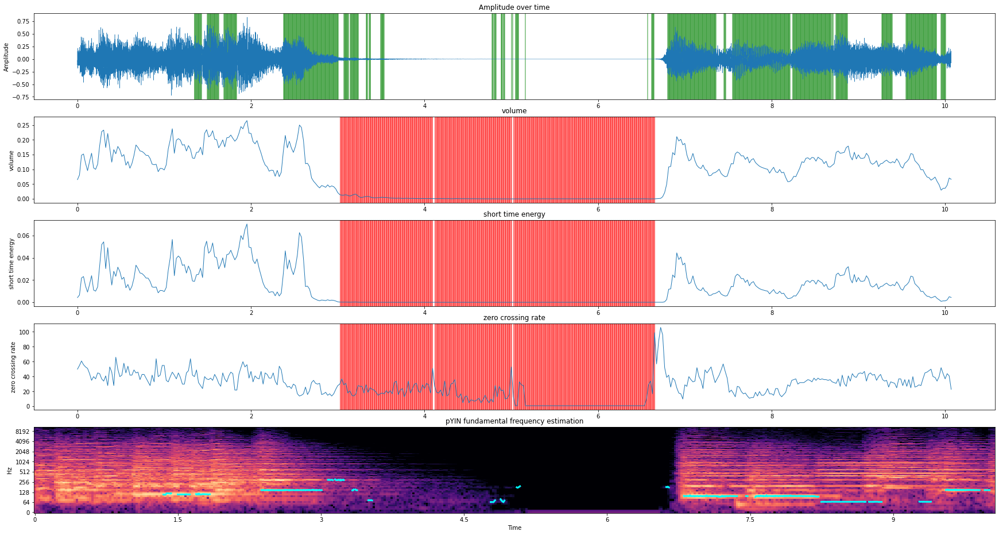

In [118]:
plot_features_df(df_music.iloc[18])

Values for the whole clip:
	 name = requiem_silence_2.wav 
	 duration = 4.590521542
	 Volume Standard Deviation = 0.2946280241
	 Volume dynamic range = 0.9972787499
	 standard deviation of ZCR = 13.3807858154	
	 High zero crossing rate = 107.5 
	 entropy = 8.8199415207 
	 Low Ste Ratio = 27.2


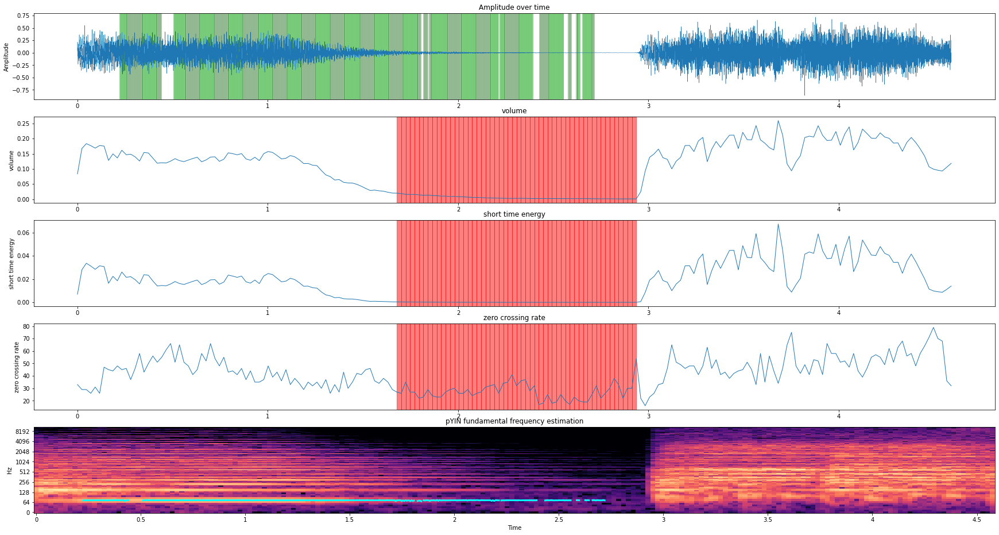

In [119]:
plot_features_df(df_music.iloc[19])

Values for the whole clip:
	 name = requiem_silence_3.wav 
	 duration = 11.3633560091
	 Volume Standard Deviation = 0.2118824571
	 Volume dynamic range = 0.9975219369
	 standard deviation of ZCR = 10.2332041563	
	 High zero crossing rate = 291.5 
	 entropy = 9.769493103 
	 Low Ste Ratio = 30.0833333333


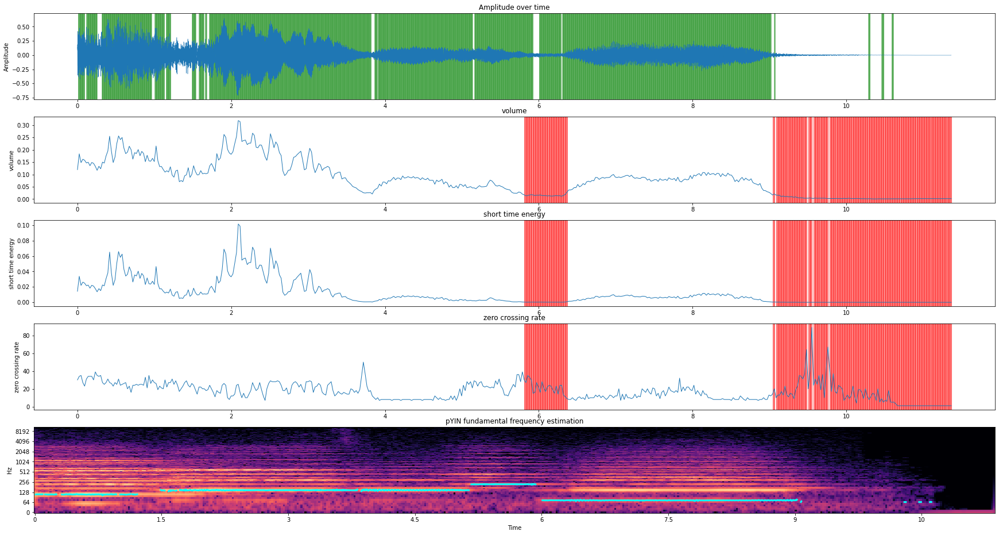

In [120]:
plot_features_df(df_music.iloc[20])

Natomiast na tych trzech nagraniach mamy już wystarczająco dużo czasu, żeby wibracje zdążyły zaniknąć - cisza wykryta  
analiza spektralna wskazuje, że niższe dźwięki dłużej wybrzmiewają w powietrzu


## 3.3 fragmenty dźwięczne i bezdźwięczne

Values for the whole clip:
	 name = cztery_3.wav 
	 duration = 0.6152380952000001
	 Volume Standard Deviation = 0.350514859
	 Volume dynamic range = 0.9809105396000001
	 standard deviation of ZCR = 58.3841636269	
	 High zero crossing rate = 15.0 
	 entropy = 5.5677771568 
	 Low Ste Ratio = 13.5


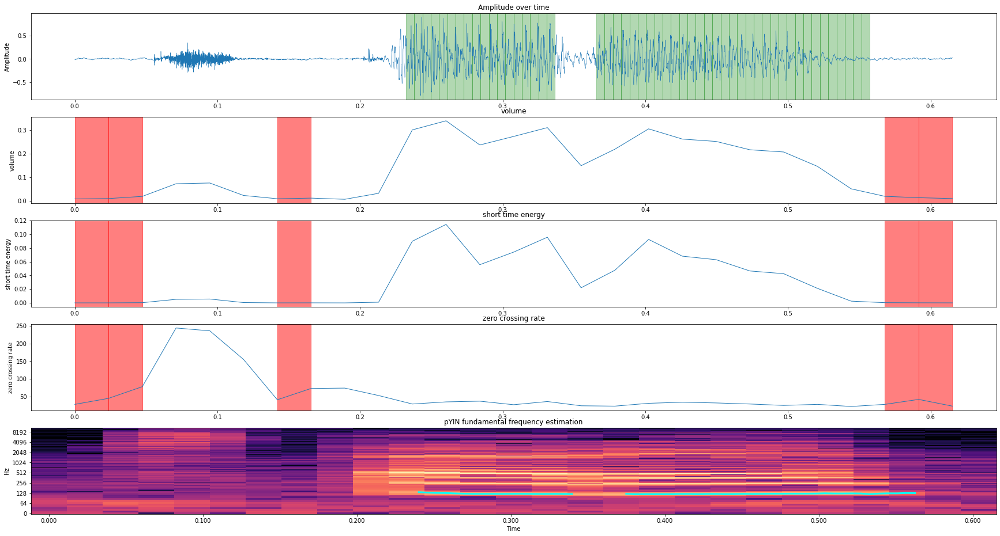

In [140]:
plot_features_df(df_male.iloc[17])

Values for the whole clip:
	 name = cztery_3.wav 
	 duration = 0.6534693878000001
	 Volume Standard Deviation = 0.2982276082
	 Volume dynamic range = 0.9953844547
	 standard deviation of ZCR = 59.2126902554	
	 High zero crossing rate = 17.5 
	 entropy = 5.8497915268 
	 Low Ste Ratio = 21.0


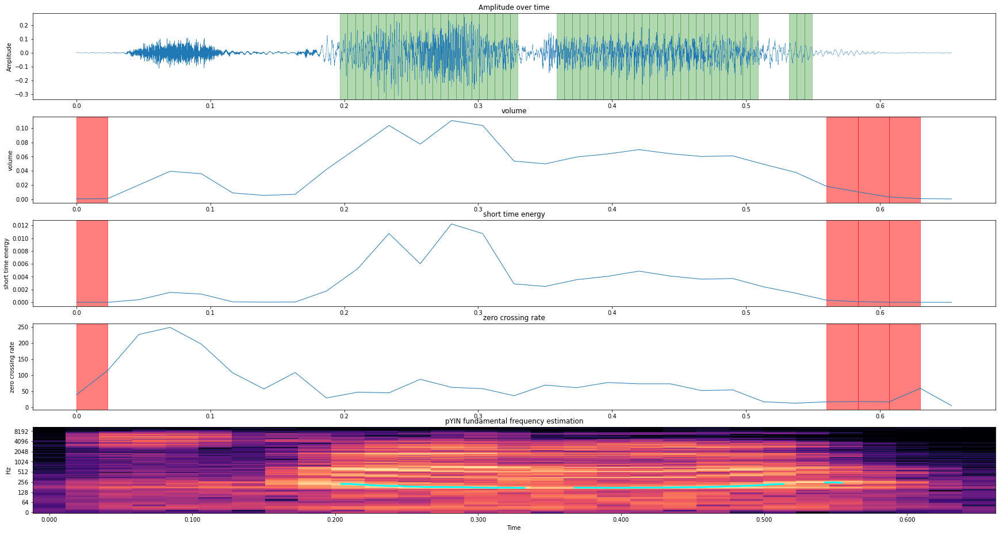

In [122]:
plot_features_df(df_female.iloc[17])

Początkowa spółgłoska "cz" nie jest rozpoznawana jako cisza, natomiast nie jest też uznawana za fragment dźwięczny - oznacza to, że mamy do czynienia z bezdźwięcznym elementem dzwiękowym

Values for the whole clip:
	 name = chrzaszcz_1.wav 
	 duration = 0.8320181406
	 Volume Standard Deviation = 0.22548376020000002
	 Volume dynamic range = 0.9933009148
	 standard deviation of ZCR = 76.7279746818	
	 High zero crossing rate = 24.0 
	 entropy = 4.716173172 
	 Low Ste Ratio = 18.0


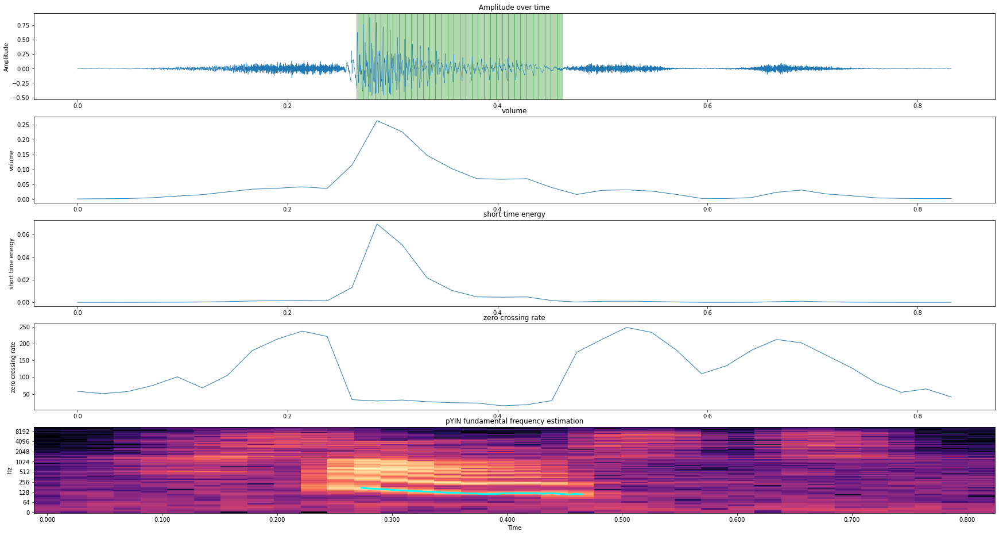

In [147]:
plot_features_df(df_male.iloc[12])

Values for the whole clip:
	 name = chrzaszcz_1.wav 
	 duration = 0.7490702948
	 Volume Standard Deviation = 0.2793756425
	 Volume dynamic range = 0.9973146319
	 standard deviation of ZCR = 76.7452944511	
	 High zero crossing rate = 21.0 
	 entropy = 5.6906638145 
	 Low Ste Ratio = 25.5


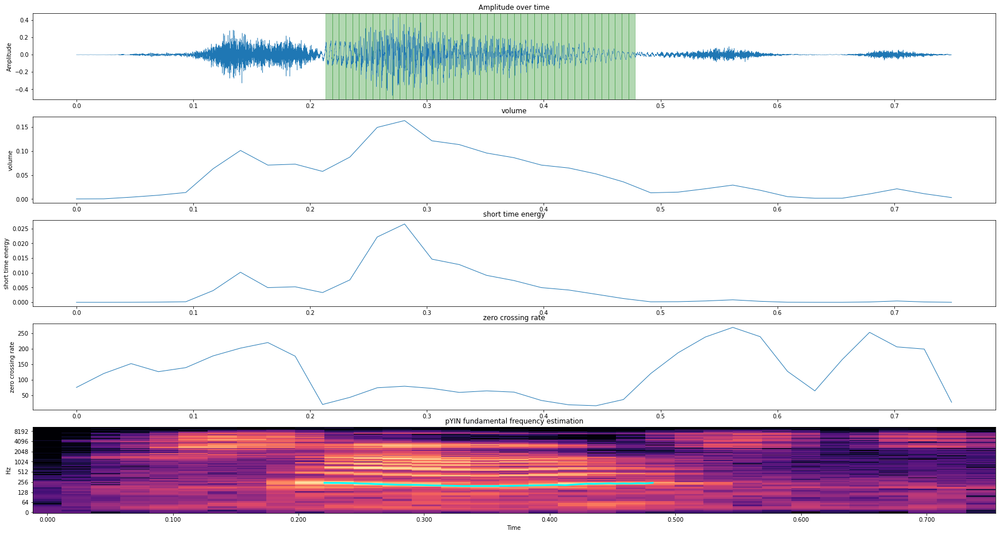

In [142]:
plot_features_df(df_female.iloc[9])

słowo "chrząszcz" zawiera w sobie kilka bezdzwięcznych głosek: "ch", "sz", "cz" - widać wyraźnie, że są to bezdzwięczne głoski, gdyż wartość ZCR jest bardzo wysoka, natomiast głośność tych głosek jest znikoma.  
Widać, że tylko dla fragmentu dźwięcznego udało się określić częstotliwość bazową

Values for the whole clip:
	 name = kurowa_2.wav 
	 duration = 0.6693877551
	 Volume Standard Deviation = 0.2949144542
	 Volume dynamic range = 0.9939554930000001
	 standard deviation of ZCR = 23.518859283	
	 High zero crossing rate = 17.0 
	 entropy = 6.0044994354 
	 Low Ste Ratio = 20.5


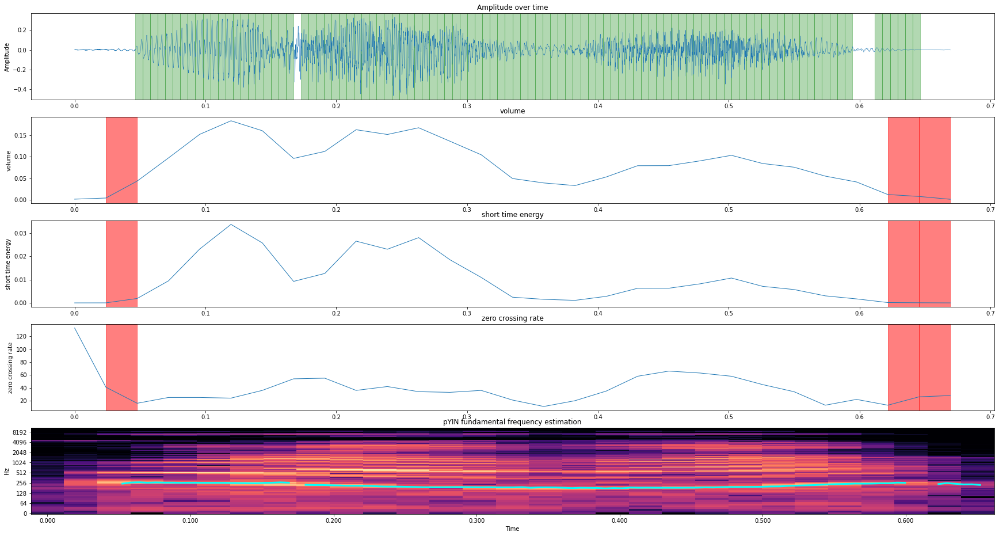

In [125]:
plot_features_df(df_female.iloc[46])

Values for the whole clip:
	 name = kurowa_2.wav 
	 duration = 0.6589569161000001
	 Volume Standard Deviation = 0.34535983200000003
	 Volume dynamic range = 0.9867095947000001
	 standard deviation of ZCR = 11.5627842061	
	 High zero crossing rate = 16.0 
	 entropy = 5.8730249405 
	 Low Ste Ratio = 14.5


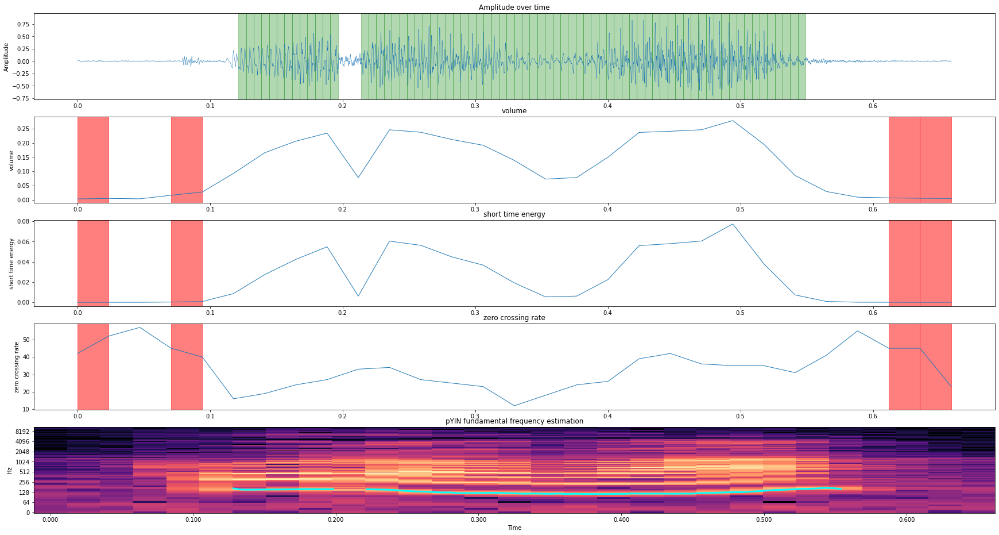

In [148]:
plot_features_df(df_male.iloc[52])

"kurowa" - bardzo dźwięczny zlepek głosek - wyraźnie to widać na wykresie - w momencie mówienia - cały jest zielony.  
Co ciekawe, ZCR jest tu bardzo niski - tylko dźwięczność (głośność) tych głosek sprawia, że nie są one klasyfikowane jako cisza 

## 3.4 porównanie głosów męskiego i damskiego

Values for the whole clip:
	 name = aba_1.wav 
	 duration = 0.49219954650000003
	 Volume Standard Deviation = 0.3228874505
	 Volume dynamic range = 0.9965066910000001
	 standard deviation of ZCR = 16.8020192608	
	 High zero crossing rate = 12.5 
	 entropy = 4.9039130211 
	 Low Ste Ratio = 11.0


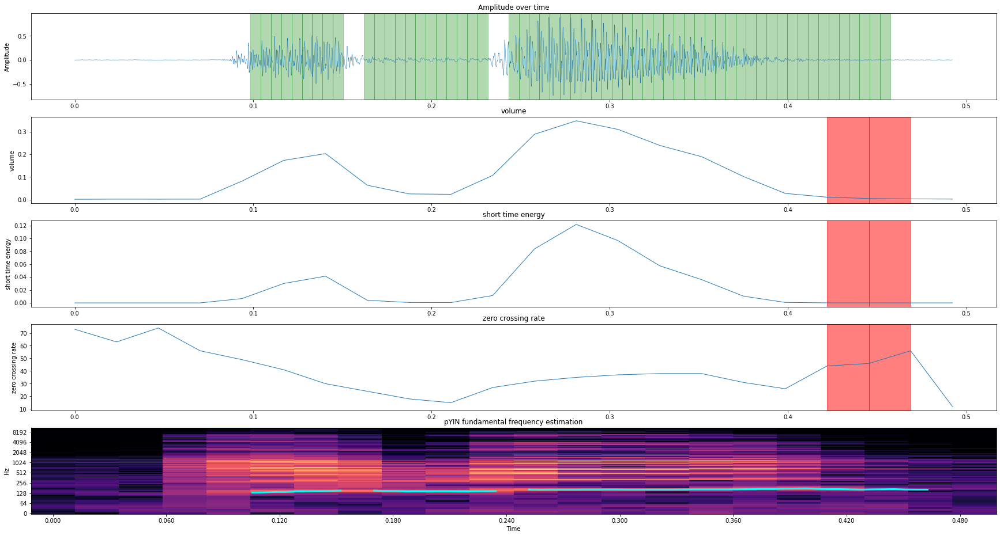

In [144]:
plot_features_df(df_male.iloc[0])

Values for the whole clip:
	 name = aba_1.wav 
	 duration = 0.5737414966000001
	 Volume Standard Deviation = 0.2964692712
	 Volume dynamic range = 0.9981126785000001
	 standard deviation of ZCR = 18.9063375618	
	 High zero crossing rate = 15.0 
	 entropy = 5.1703777313 
	 Low Ste Ratio = 20.0


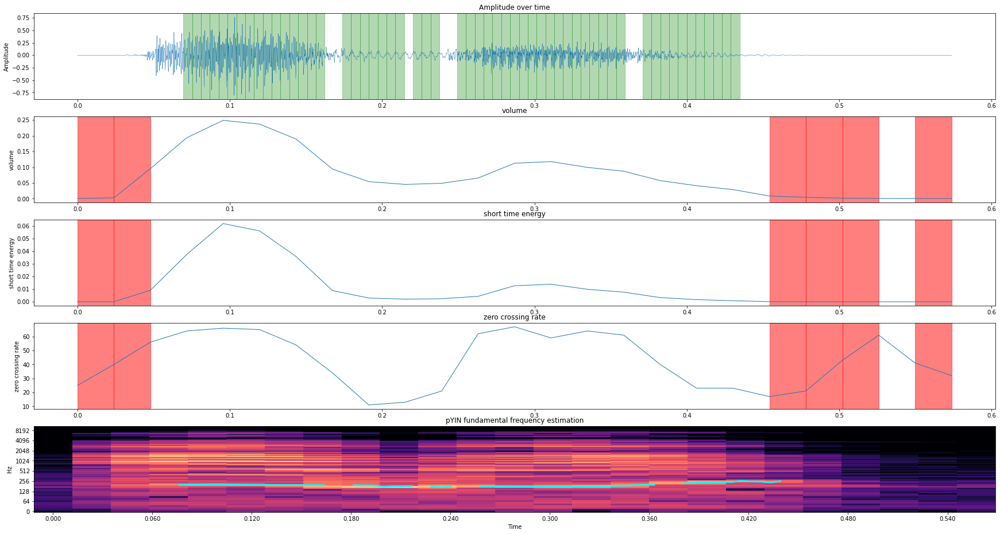

In [128]:
plot_features_df(df_female.iloc[0])

Values for the whole clip:
	 name = abe_2.wav 
	 duration = 0.373106576
	 Volume Standard Deviation = 0.3599754572
	 Volume dynamic range = 0.9907445312000001
	 standard deviation of ZCR = 13.7800316892	
	 High zero crossing rate = 9.5 
	 entropy = 5.132830143 
	 Low Ste Ratio = 8.5


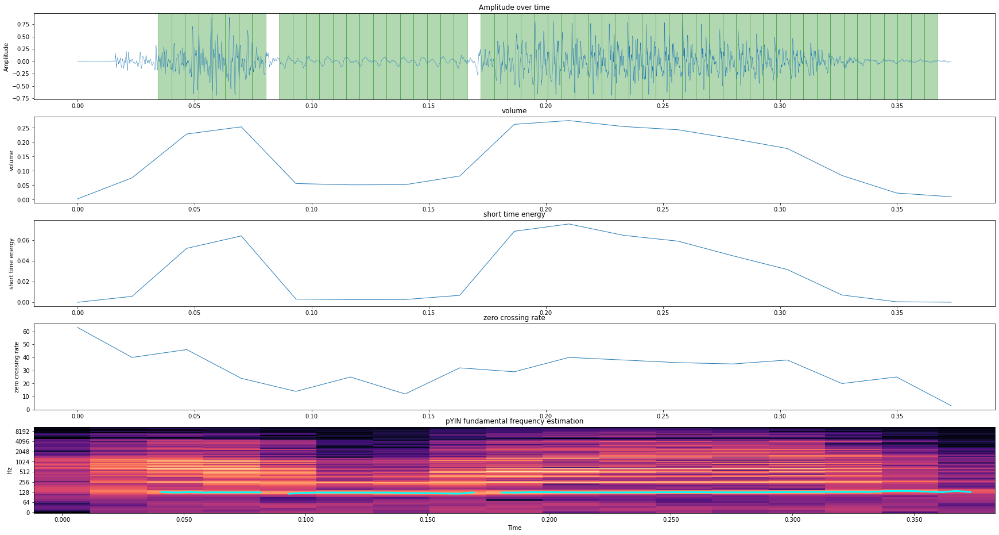

In [145]:
plot_features_df(df_male.iloc[4])

Values for the whole clip:
	 name = abe_2.wav 
	 duration = 0.5578231293
	 Volume Standard Deviation = 0.2782168984
	 Volume dynamic range = 0.9973115921000001
	 standard deviation of ZCR = 20.5330562752	
	 High zero crossing rate = 14.5 
	 entropy = 5.537788868 
	 Low Ste Ratio = 18.5


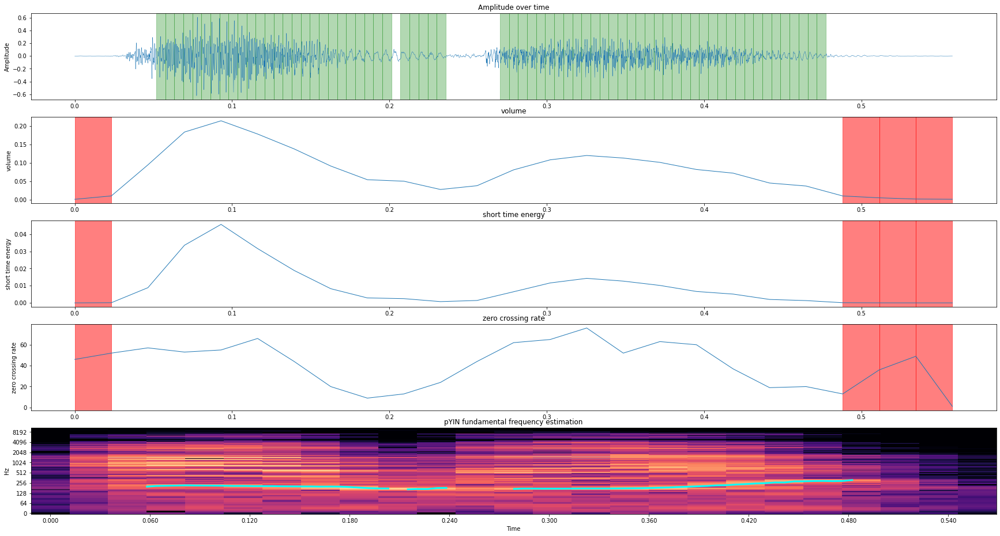

In [149]:
plot_features_df(df_female.iloc[4])

Values for the whole clip:
	 name = bub_1.wav 
	 duration = 0.4167800454
	 Volume Standard Deviation = 0.2951734066
	 Volume dynamic range = 0.9923584461
	 standard deviation of ZCR = 8.1257478288	
	 High zero crossing rate = 10.0 
	 entropy = 4.5371322632 
	 Low Ste Ratio = 9.0


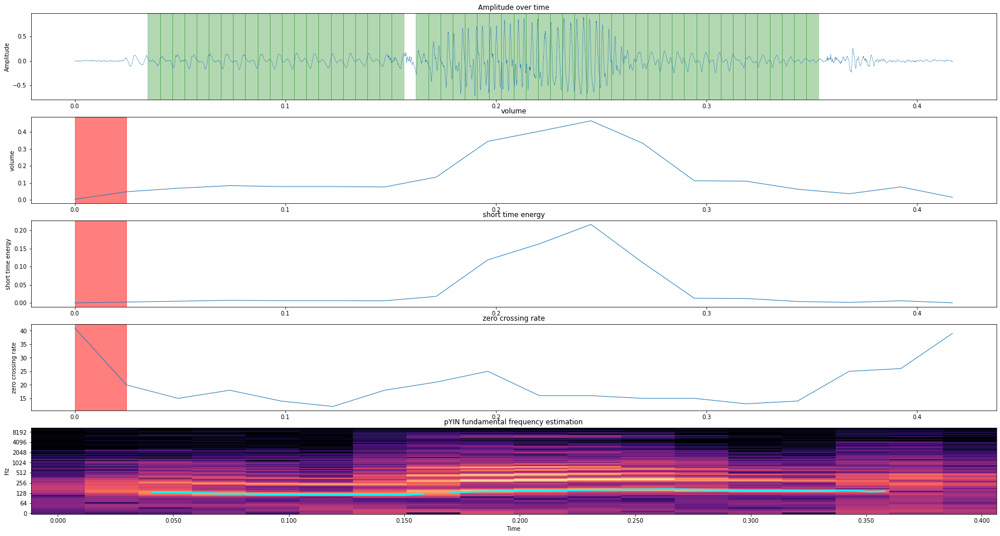

In [146]:
plot_features_df(df_male.iloc[9])

Values for the whole clip:
	 name = bob_2.wav 
	 duration = 0.46222222220000003
	 Volume Standard Deviation = 0.3241076171
	 Volume dynamic range = 0.9892414212
	 standard deviation of ZCR = 5.018714975	
	 High zero crossing rate = 11.0 
	 entropy = 5.075820446 
	 Low Ste Ratio = 16.0


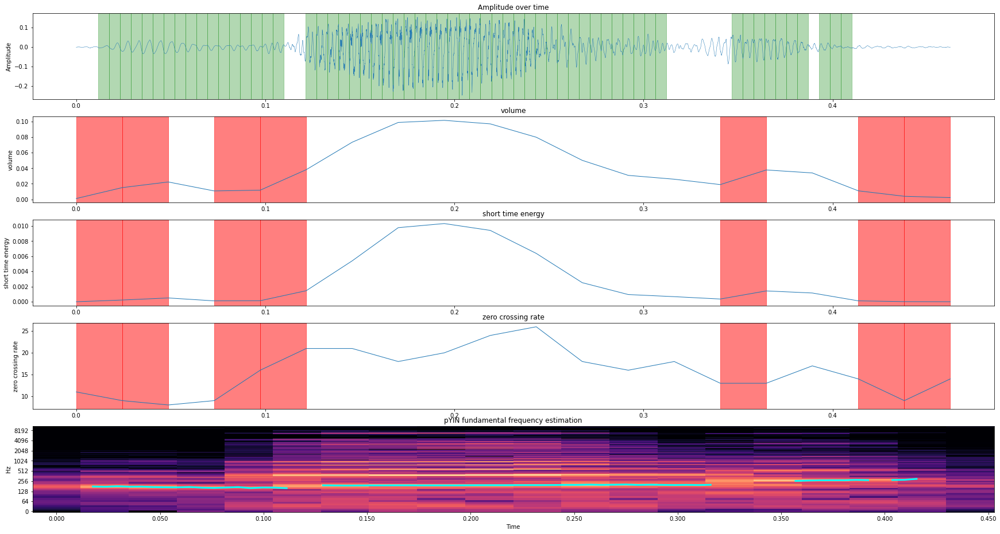

In [132]:
plot_features_df(df_female.iloc[7])

Values for the whole clip:
	 name = omoltyk_2.wav 
	 duration = 0.7303401361
	 Volume Standard Deviation = 0.2978987098
	 Volume dynamic range = 0.9894952774
	 standard deviation of ZCR = 19.9714395685	
	 High zero crossing rate = 18.5 
	 entropy = 5.6657915115 
	 Low Ste Ratio = 16.0


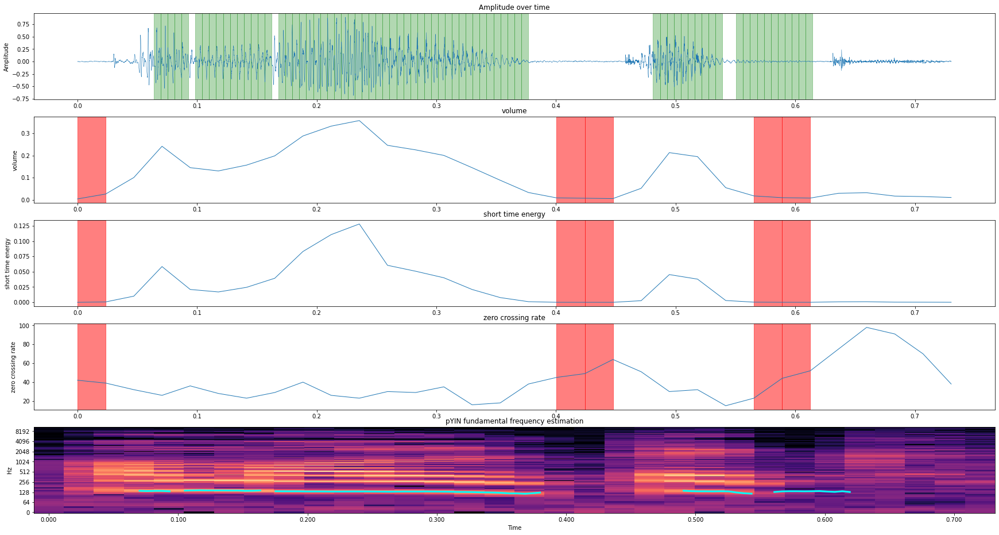

In [150]:
plot_features_df(df_male.iloc[58])

Values for the whole clip:
	 name = omoltyk_2.wav 
	 duration = 0.7012698413
	 Volume Standard Deviation = 0.32508638500000003
	 Volume dynamic range = 0.9973699450000001
	 standard deviation of ZCR = 25.822575608	
	 High zero crossing rate = 16.5 
	 entropy = 5.7213840485 
	 Low Ste Ratio = 24.5


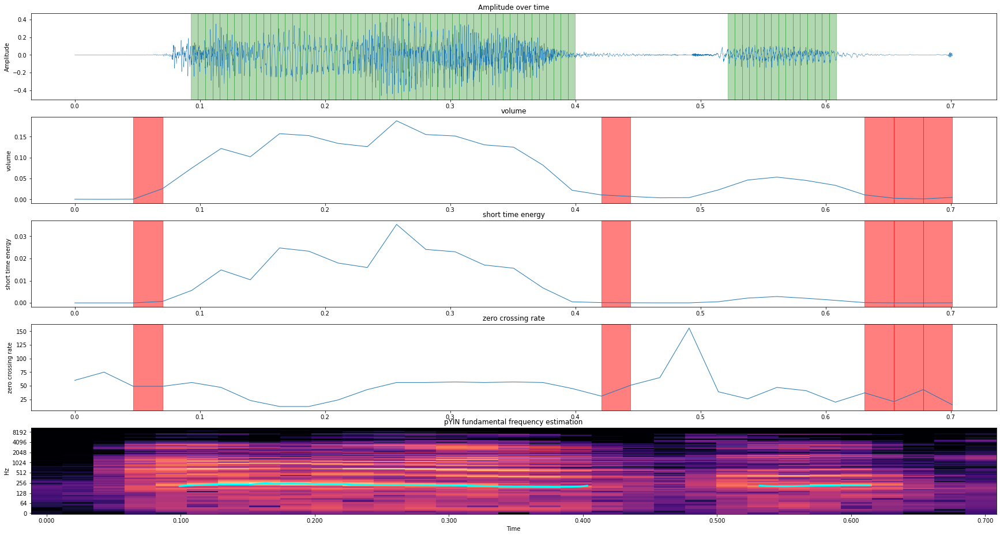

In [152]:
plot_features_df(df_female.iloc[52])

W porównaniu z koleżanką, moje nagrania różnią się:
 * u koleżanki zaobserwować możemy (na większości nagrań) wyższe odchylenie standardowe ZCR - oznacza to, że jej głos ma większe fluktuacje w stosunku do moich nagrań
 * najważniejszym elementem wykorzystywanym do rozróżniania czy dane nagranie jest głosem męskim, czy damskim jest f0 - częstotliwość bazowa - jej wartości dla głosu męskiego w dużej większości (statystycznie) znajdują się w zakresie 60 - 180 Hz, natomiast głos damski - 165-255 Hz ( przy normalnej rozmowie ) (niestety nie jest to tak wyraźne jak bym chciał, ponieważ mój głos jest relatywnie wysoki)

Values for the whole clip:
	 name = requiem_vocal_5.wav 
	 duration = 3.6272562358
	 Volume Standard Deviation = 0.1748656929
	 Volume dynamic range = 0.839204967
	 standard deviation of ZCR = 7.8743273129	
	 High zero crossing rate = 78.5 
	 entropy = 8.9723720551 
	 Low Ste Ratio = 23.375


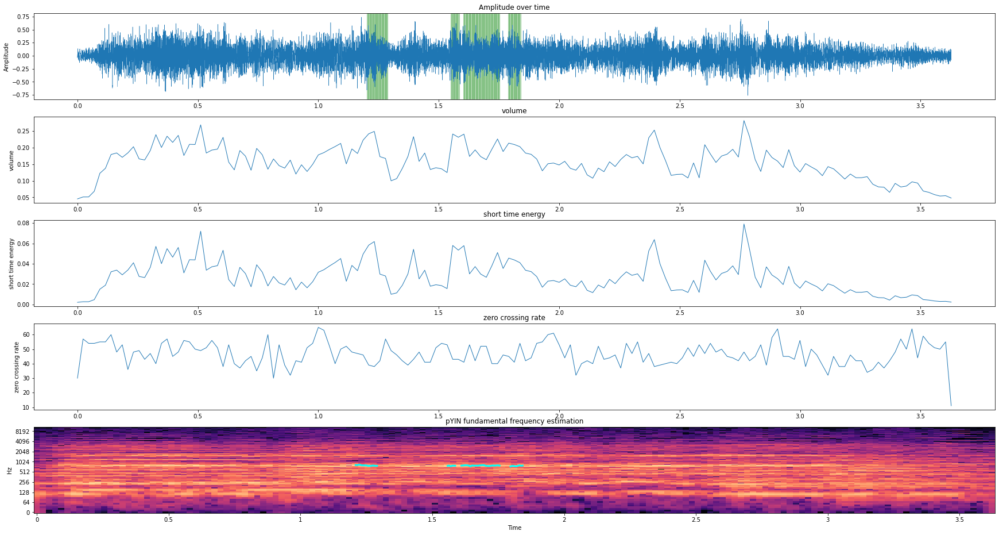

In [156]:
plot_features_df(df_music.iloc[25])

Values for the whole clip:
	 name = requiem_vocal_male.wav 
	 duration = 3.3713832200000002
	 Volume Standard Deviation = 0.17394709590000001
	 Volume dynamic range = 0.8743211627
	 standard deviation of ZCR = 12.3399568703	
	 High zero crossing rate = 78.5 
	 entropy = 8.8024339676 
	 Low Ste Ratio = 22.125


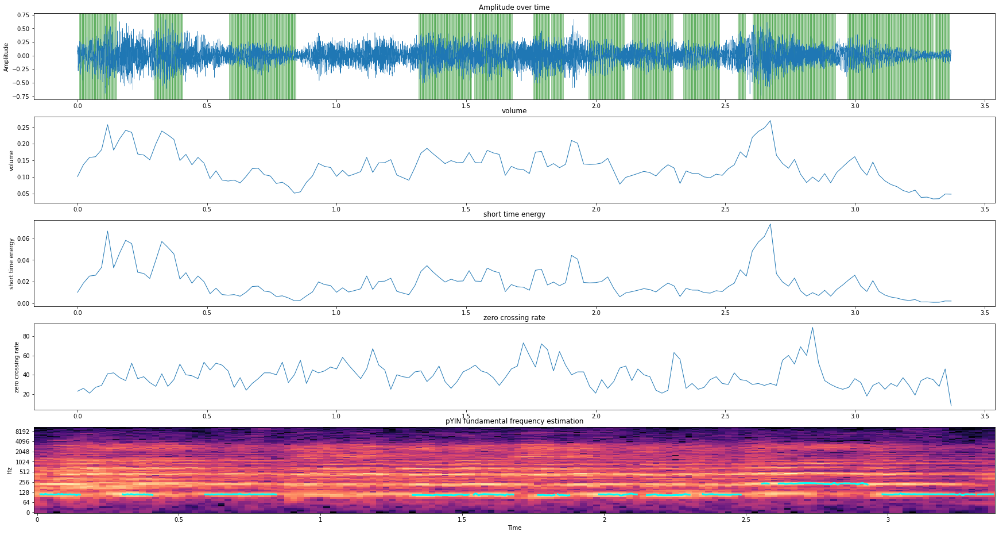

In [159]:
plot_features_df(df_music.iloc[26])

dwa podobne fragmenty utworu muzycznego, pierwszy z głosem damskim, drugi z głosem męskim - wyraźnie dostrzegalna różnica  
na pierwszym nagraniu trudniej jest wyłapać głos z natłoku wszystkich dźwięków, ponieważ jest on znacznie wyższy  (Sopran ~1000 Hz) - trudniej wyłapać częstotliwość bazową, widać jednak, że we fragmentach w których się to udało, rzeczywiście wskazania są na ~1000 Hz  
na drugim nagraniu, bardzo dobrze udało się wyznaczyć głos męski ( Baryton/Bas ~100 Hz )

## 3.5 porównanie muzyki, głosu, oraz muzyki i głosu

Values for the whole clip:
	 name = mop_guitar_1.wav 
	 duration = 3.7797278912000003
	 Volume Standard Deviation = 0.1492118388
	 Volume dynamic range = 0.6245492697
	 standard deviation of ZCR = 18.2417615742	
	 High zero crossing rate = 94.0 
	 entropy = 9.163061142 
	 Low Ste Ratio = 22.125


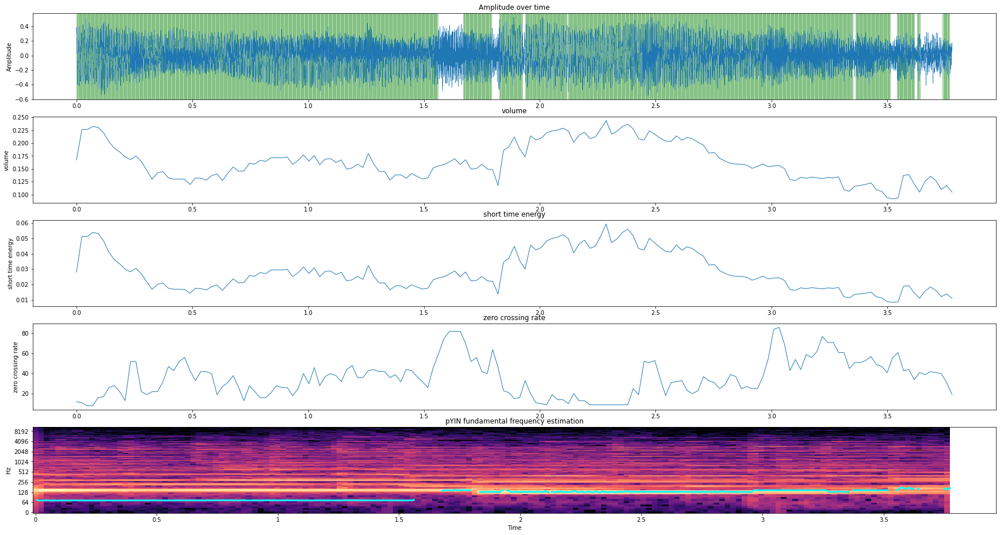

In [168]:
plot_features_df(df_music.iloc[4])

Values for the whole clip:
	 name = mop_electric_1.wav 
	 duration = 4.0995464853
	 Volume Standard Deviation = 0.12724497910000002
	 Volume dynamic range = 0.8889531493
	 standard deviation of ZCR = 29.3770197351	
	 High zero crossing rate = 106.0 
	 entropy = 9.0104999542 
	 Low Ste Ratio = 22.5


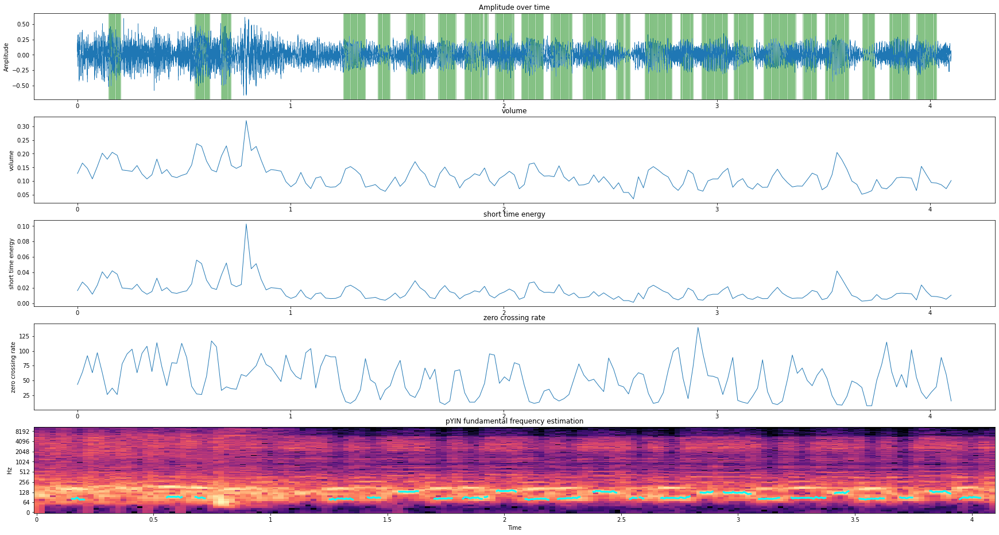

In [135]:
plot_features_df(df_music.iloc[2])

Values for the whole clip:
	 name = requiem_silence_3.wav 
	 duration = 11.3633560091
	 Volume Standard Deviation = 0.2118824571
	 Volume dynamic range = 0.9975219369
	 standard deviation of ZCR = 10.2332041563	
	 High zero crossing rate = 291.5 
	 entropy = 9.769493103 
	 Low Ste Ratio = 30.0833333333


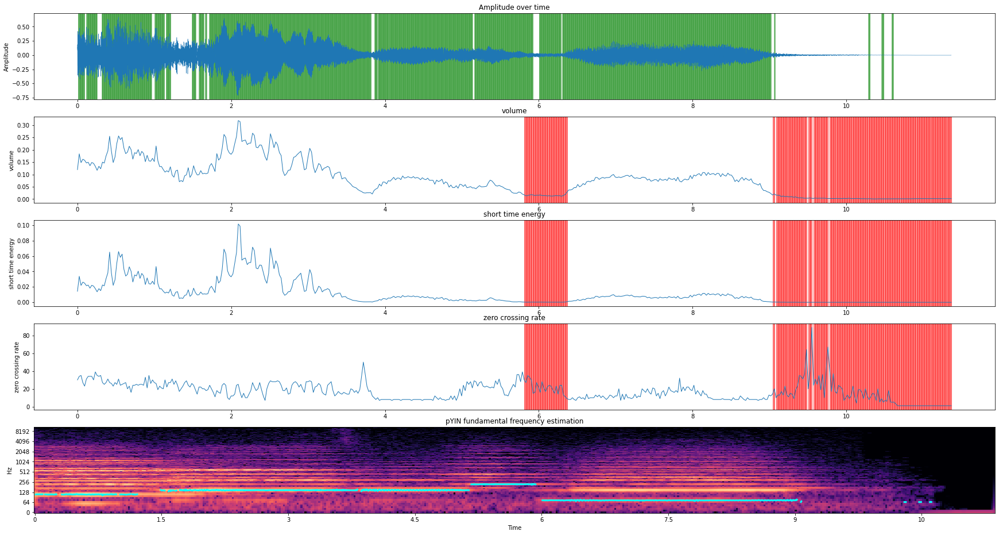

In [153]:
plot_features_df(df_music.iloc[21])

W drugiej części nagrania skrzypce dobrze udają głos - przynajmniej jeśli chodzi o analizę spektralną - bardzo czysty dźwięk z wyraźną częstotliwością bazową

Values for the whole clip:
	 name = zdanie_3.wav 
	 duration = 2.9980045351
	 Volume Standard Deviation = 0.2396664023
	 Volume dynamic range = 0.9904549718000001
	 standard deviation of ZCR = 56.83921265	
	 High zero crossing rate = 76.0 
	 entropy = 7.6191401482 
	 Low Ste Ratio = 34.1666666667


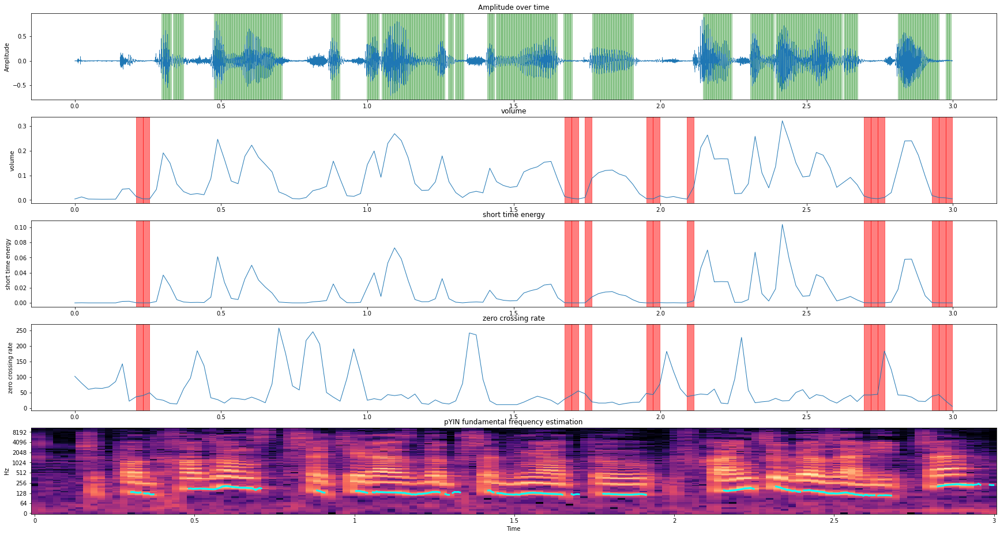

In [165]:
plot_features_df(df_male.iloc[99])

Values for the whole clip:
	 name = zdanie_2.wav 
	 duration = 3.4585034014
	 Volume Standard Deviation = 0.21146719160000002
	 Volume dynamic range = 0.995375216
	 standard deviation of ZCR = 53.612481613599996	
	 High zero crossing rate = 86.0 
	 entropy = 8.2468166351 
	 Low Ste Ratio = 107.0


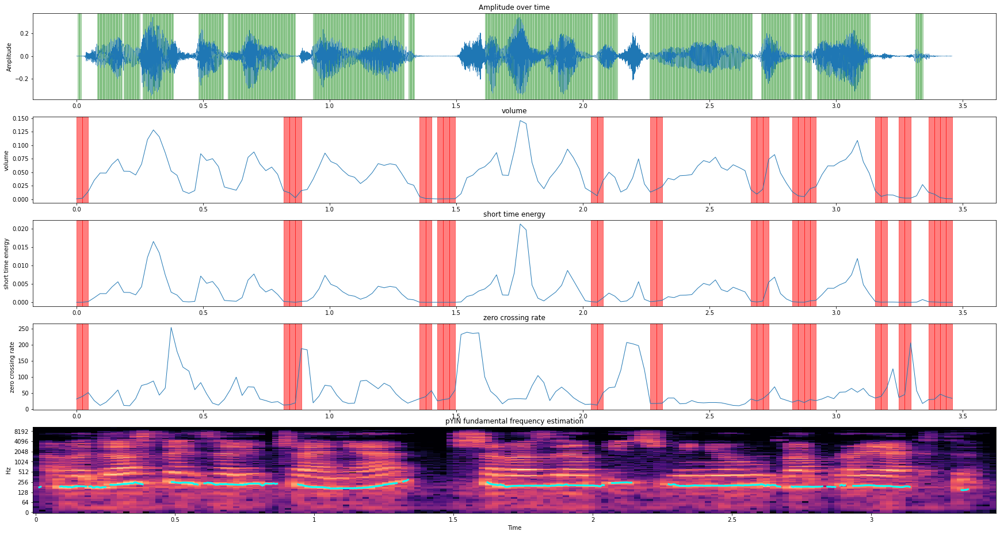

In [167]:
plot_features_df(df_female.iloc[97])

Dwie główne cechy pozwalają odróżniać muzykę od głosu - odchylenie standardowe ZCR - w mowie jest wyższe, ponieważ mowa, w przeciwieństwie do muzyki, nie musi być spójna brzmieniowo, a sensowo. Mowa potoczna będzie miała z reguły znacznie wyższe odchylenie ZCR niż muzyka  
Wartość współczynnika krótkookresowej niskiej energii - dla mowy powinien być wyższy, ponieważ mowa zawiera znacznie więcej cichych / bezdzwięcznych fragmentów niż muzyka (potwierdzają to wartości wyekstrahowanych cech)